In [4]:
import urllib.request
from bs4 import BeautifulSoup

import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

print('Libraries imported.')

Libraries imported.


In [5]:
!conda install -c conda-forge folium=0.5.0 --yes
import folium

print('Folium installed and imported!')

Solving environment: done

## Package Plan ##

  environment location: /opt/conda/envs/Python36

  added / updated specs: 
    - folium=0.5.0


The following packages will be UPDATED:

    certifi:         2020.6.20-py36_0 --> 2020.6.20-py36h9f0ad1d_0 conda-forge

The following packages will be DOWNGRADED:

    ca-certificates: 2020.6.24-0      --> 2020.6.20-hecda079_0     conda-forge

Preparing transaction: done
Verifying transaction: done
Executing transaction: done
Folium installed and imported!


In [1]:
!conda install -c conda-forge geopy --yes
from geopy.geocoders import Nominatim

Solving environment: done

## Package Plan ##

  environment location: /opt/conda/envs/Python36

  added / updated specs: 
    - geopy


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    geopy-2.0.0                |     pyh9f0ad1d_0          63 KB  conda-forge
    geographiclib-1.50         |             py_0          34 KB  conda-forge
    ------------------------------------------------------------
                                           Total:          97 KB

The following NEW packages will be INSTALLED:

    geographiclib: 1.50-py_0          conda-forge
    geopy:         2.0.0-pyh9f0ad1d_0 conda-forge


geopy-2.0.0          | 63 KB     | ##################################### | 100% 
geographiclib-1.50   | 34 KB     | ##################################### | 100% 
Preparing transaction: done
Verifying transaction: done
Executing transaction: done


In [2]:
!conda install -c districtdatalabs yellowbrick

from yellowbrick.cluster import KElbowVisualizer

Solving environment: done

## Package Plan ##

  environment location: /opt/conda/envs/Python36

  added / updated specs: 
    - yellowbrick


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    yellowbrick-1.1            |           py36_0         276 KB  districtdatalabs
    pytest-runner-5.2          |             py_0          13 KB
    ------------------------------------------------------------
                                           Total:         289 KB

The following NEW packages will be INSTALLED:

    pytest-runner:   5.2-py_0                                 
    yellowbrick:     1.1-py36_0               districtdatalabs

The following packages will be UPDATED:

    ca-certificates: 2020.6.20-hecda079_0     conda-forge      --> 2020.6.24-0     
    certifi:         2020.6.20-py36h9f0ad1d_0 conda-forge      --> 2020.6.20-py36_0


yellowbrick-1.1      | 276 KB    | ##############

In [6]:
url = "https://en.wikipedia.org/wiki/List_of_postal_codes_of_Canada:_M"
page = urllib.request.urlopen(url)
soup = BeautifulSoup(page, "lxml")
#print(soup.prettify())

In [7]:
post_table = soup.find('table', class_='wikitable sortable')
#post_table

In [8]:
A=[]
B=[]
C=[]

for row in post_table.findAll('tr'):
    cells=row.findAll('td')
    if len(cells) == 3:
        A.append(cells[0].find(text=True).strip())
        B.append(cells[1].find(text=True).strip())
        C.append(cells[2].find(text=True).strip())

In [9]:
import pandas as pd
df=pd.DataFrame(A,columns=['PostalCode'])
df['Borough']=B
df['Neighborhood']=C
df.head(10)

,PostalCode,Borough,Neighborhood
0,M1A,Not assigned,Not assigned
1,M2A,Not assigned,Not assigned
2,M3A,North York,Parkwoods
3,M4A,North York,Victoria Village
4,M5A,Downtown Toronto,"Regent Park, Harbourfront"
5,M6A,North York,"Lawrence Manor, Lawrence Heights"
6,M7A,Downtown Toronto,"Queen's Park, Ontario Provincial Government"
7,M8A,Not assigned,Not assigned
8,M9A,Etobicoke,"Islington Avenue, Humber Valley Village"
9,M1B,Scarborough,"Malvern, Rouge"


In [10]:
df1 = df[df.Borough != "Not assigned"]
df1.head()

,PostalCode,Borough,Neighborhood
2,M3A,North York,Parkwoods
3,M4A,North York,Victoria Village
4,M5A,Downtown Toronto,"Regent Park, Harbourfront"
5,M6A,North York,"Lawrence Manor, Lawrence Heights"
6,M7A,Downtown Toronto,"Queen's Park, Ontario Provincial Government"


In [11]:
df1.shape

(103, 3)

# Get Latitude and Longitude of all Postal Code

In [12]:
path = 'http://cocl.us/Geospatial_data/Geospatial_data.csv'
df_position= pd.read_csv(path)
df_position.rename({'Postal Code': 'PostalCode'}, axis=1, inplace=True)
df_position.head()

,PostalCode,Latitude,Longitude
0,M1B,43.806686,-79.194353
1,M1C,43.784535,-79.160497
2,M1E,43.763573,-79.188711
3,M1G,43.770992,-79.216917
4,M1H,43.773136,-79.239476


In [13]:
neighbour_with_latlong = pd.merge(df1, df_position, on='PostalCode', how='left')
neighbour_with_latlong.head()

,PostalCode,Borough,Neighborhood,Latitude,Longitude
0,M3A,North York,Parkwoods,43.753259,-79.329656
1,M4A,North York,Victoria Village,43.725882,-79.315572
2,M5A,Downtown Toronto,"Regent Park, Harbourfront",43.654260,-79.360636
3,M6A,North York,"Lawrence Manor, Lawrence Heights",43.718518,-79.464763
4,M7A,Downtown Toronto,"Queen's Park, Ontario Provincial Government",43.662301,-79.389494


# Join Both Dataset

In [14]:
# define the dataframe columns

#column_names = ['PostalCode', 'Borough', 'Neighborhood', 'Latitude', 'Longitude'] 

# instantiate the dataframe
#new_dataset = pd.DataFrame(columns=column_names)
#for data in df1.iterrows():
#    new_dataset = new_dataset.append({'PostalCode': data[1]['PostalCode'],
#                                      'Borough': data[1]['Borough'],
#                                      'Neighborhood': data[1]['Neighborhood'],
#                                      'Latitude': df_position[(df_position.PostalCode == data[1]['PostalCode'])]['Latitude'].values[0],
#                                      'Longitude': df_position[(df_position.PostalCode == data[1]['PostalCode'])]['Longitude'].values[0]
#                                     }, ignore_index=True)
new_dataset = pd.merge(df1, df_position, on='PostalCode', how='left')
new_dataset.head()

,PostalCode,Borough,Neighborhood,Latitude,Longitude
0,M3A,North York,Parkwoods,43.753259,-79.329656
1,M4A,North York,Victoria Village,43.725882,-79.315572
2,M5A,Downtown Toronto,"Regent Park, Harbourfront",43.654260,-79.360636
3,M6A,North York,"Lawrence Manor, Lawrence Heights",43.718518,-79.464763
4,M7A,Downtown Toronto,"Queen's Park, Ontario Provincial Government",43.662301,-79.389494


In [15]:
# define the dataframe columns
column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 

# instantiate the dataframe
neighborhoods = pd.DataFrame(columns=column_names)
neighborhoods



,Borough,Neighborhood,Latitude,Longitude


In [16]:
for data in new_dataset.iterrows():
    #print(data)
    borough = data[1]['Borough'] 
    neighborhood_name = data[1]['Neighborhood'].split(',')
        
    
    neighborhood_lat = data[1]['Latitude']
    neighborhood_lon = data[1]['Longitude']
    
    for neighbor in neighborhood_name:
        neighborhoods = neighborhoods.append({'Borough': borough,
                                              'Neighborhood': neighbor,
                                              'Latitude': neighborhood_lat,
                                              'Longitude': neighborhood_lon}, ignore_index=True)
    
    
neighborhoods.head()

,Borough,Neighborhood,Latitude,Longitude
0,North York,Parkwoods,43.753259,-79.329656
1,North York,Victoria Village,43.725882,-79.315572
2,Downtown Toronto,Regent Park,43.654260,-79.360636
3,Downtown Toronto,Harbourfront,43.654260,-79.360636
4,North York,Lawrence Manor,43.718518,-79.464763


# Get Latitude and Longitude for Toranto, Ontario for plotting map

In [17]:
address = 'Toronto, Ontario'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Toronto, Ontario are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Toronto, Ontario are 43.6534817, -79.3839347.


# Get Area Details of neighborhoods

In [18]:
#https://open.toronto.ca/dataset/neighbourhood-profiles/
import pandas as pd
import requests

# Get the dataset metadata by passing package_id to the package_search endpoint
# For example, to retrieve the metadata for this dataset:

url = "https://ckan0.cf.opendata.inter.prod-toronto.ca/api/3/action/package_show"
params = { "id": "6e19a90f-971c-46b3-852c-0c48c436d1fc"}
package = requests.get(url, params = params).json()
#print(package["result"])

# Get the data by passing the resource_id to the datastore_search endpoint
# See https://docs.ckan.org/en/latest/maintaining/datastore.html for detailed parameters options
# For example, to retrieve the data content for the first resource in the datastore:

for idx, resource in enumerate(package["result"]["resources"]):
    if resource["datastore_active"]:
        url = "https://ckan0.cf.opendata.inter.prod-toronto.ca/api/3/action/datastore_search"
        p = { "id": resource["id"] }
        data = requests.get(url, params = p).json()
        df_neighbourprofiles = pd.DataFrame(data["result"]["records"])
        break
df_neighbourprofiles

,Agincourt North,Agincourt South-Malvern West,Alderwood,Annex,Banbury-Don Mills,Bathurst Manor,Bay Street Corridor,Bayview Village,Bayview Woods-Steeles,Bedford Park-Nortown,Beechborough-Greenbrook,Bendale,Birchcliffe-Cliffside,Black Creek,Blake-Jones,Briar Hill-Belgravia,Bridle Path-Sunnybrook-York Mills,Broadview North,Brookhaven-Amesbury,Cabbagetown-South St. James Town,Caledonia-Fairbank,Casa Loma,Category,Centennial Scarborough,Characteristic,Church-Yonge Corridor,City of Toronto,Clairlea-Birchmount,Clanton Park,Cliffcrest,Corso Italia-Davenport,Danforth,Danforth East York,Data Source,Don Valley Village,Dorset Park,Dovercourt-Wallace Emerson-Junction,Downsview-Roding-CFB,Dufferin Grove,East End-Danforth,Edenbridge-Humber Valley,Eglinton East,Elms-Old Rexdale,Englemount-Lawrence,Eringate-Centennial-West Deane,Etobicoke West Mall,Flemingdon Park,Forest Hill North,Forest Hill South,Glenfield-Jane Heights,Greenwood-Coxwell,Guildwood,Henry Farm,High Park North,High Park-Swansea,Highland Creek,Hillcrest Village,Humber Heights-Westmount,Humber Summit,Humbermede,Humewood-Cedarvale,Ionview,Islington-City Centre West,Junction Area,Keelesdale-Eglinton West,Kennedy Park,Kensington-Chinatown,Kingsview Village-The Westway,Kingsway South,L'Amoreaux,Lambton Baby Point,Lansing-Westgate,Lawrence Park North,Lawrence Park South,Leaside-Bennington,Little Portugal,Long Branch,Malvern,Maple Leaf,Markland Wood,Milliken,Mimico (includes Humber Bay Shores),Morningside,Moss Park,Mount Dennis,Mount Olive-Silverstone-Jamestown,Mount Pleasant East,Mount Pleasant West,New Toronto,Newtonbrook East,Newtonbrook West,Niagara,North Riverdale,North St. James Town,O'Connor-Parkview,Oakridge,Oakwood Village,Old East York,Palmerston-Little Italy,Parkwoods-Donalda,Pelmo Park-Humberlea,Playter Estates-Danforth,Pleasant View,Princess-Rosethorn,Regent Park,Rexdale-Kipling,Rockcliffe-Smythe,Roncesvalles,Rosedale-Moore Park,Rouge,Runnymede-Bloor West Village,Rustic,Scarborough Village,South Parkdale,South Riverdale,St.Andrew-Windfields,Steeles,Stonegate-Queensway,Tam O'Shanter-Sullivan,Taylor-Massey,The Beaches,Thistletown-Beaumond Heights,Thorncliffe Park,Topic,Trinity-Bellwoods,University,Victoria Village,Waterfront Communities-The Island,West Hill,West Humber-Clairville,Westminster-Branson,Weston,Weston-Pelham Park,Wexford/Maryvale,Willowdale East,Willowdale West,Willowridge-Martingrove-Richview,Woburn,Woodbine Corridor,Woodbine-Lumsden,Wychwood,Yonge-Eglinton,Yonge-St.Clair,York University Heights,Yorkdale-Glen Park,_id
0,129,128,20,95,42,34,76,52,49,39,112,127,122,24,69,108,41,57,30,71,109,96,Neighbourhood Information,133,Neighbourhood Number,75,n/a,120,33,123,92,66,59,City of Toronto,47,126,93,26,83,62,9,138,5,32,11,13,44,102,101,25,65,140,53,88,87,134,48,8,21,22,106,125,14,90,110,124,78,6,15,117,114,38,105,103,56,84,19,132,29,12,130,17,135,73,115,2,99,104,18,50,36,82,68,74,54,121,107,58,80,45,23,67,46,10,72,4,111,86,98,131,89,28,139,85,70,40,116,16,118,61,63,3,55,Neighbourhood Information,81,79,43,77,136,1,35,113,91,119,51,37,7,137,64,60,94,100,97,27,31,1
1,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,NIA,No Designation,No Designation,NIA,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,Neighbourhood Information,No Designation,TSNS2020 Designation,No Designation,n/a,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,City of Toronto,No Designation,Emerging Neighbourhood,No Designation,NIA,No Designation,No Designation,No Designation,NIA,NIA,Emerging Neighbourhood,No Designation,No Designation,NIA,No Designation,No Designation,NIA,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,Emerging Neighbourhood,NIA,NIA,No Designation,NIA,No Designation,No Designation,NIA,NIA,No Designation,NIA,No Designati

In [19]:
#GeoJson - https://open.toronto.ca/dataset/neighbourhoods/
import pandas as pd
import requests
 
# Get the dataset metadata by passing package_id to the package_search endpoint
# For example, to retrieve the metadata for this dataset:
 
url = "https://ckan0.cf.opendata.inter.prod-toronto.ca/api/3/action/package_show"
params = { "id": "4def3f65-2a65-4a4f-83c4-b2a4aed72d46"}
package = requests.get(url, params = params).json()
#print(package["result"])
 
# Get the data by passing the resource_id to the datastore_search endpoint
# See https://docs.ckan.org/en/latest/maintaining/datastore.html for detailed parameters options
# For example, to retrieve the data content for the first resource in the datastore:
 
for idx, resource in enumerate(package["result"]["resources"]):
    if resource["datastore_active"]:
        url = "https://ckan0.cf.opendata.inter.prod-toronto.ca/api/3/action/datastore_search"
        p = { "id": resource["id"] }
        data = requests.get(url, params = p).json()
        df_neighbourhoods = pd.DataFrame(data["result"]["records"])
        break
df_neighbourhoods

,AREA_ATTR_ID,AREA_DESC,AREA_ID,AREA_LONG_CODE,AREA_NAME,AREA_SHORT_CODE,LATITUDE,LONGITUDE,OBJECTID,PARENT_AREA_ID,Shape__Area,Shape__Length,X,Y,_id,geometry
0,25926662,Wychwood (94),25886861,094,Wychwood (94),094,43.676919,-79.425515,16491505,49885,3.217960e+06,7515.779658,None,None,6721,"{""type"": ""Polygon"", ""coordinates"": [[[-79.4359..."
1,25926663,Yonge-Eglinton (100),25886820,100,Yonge-Eglinton (100),100,43.704689,-79.403590,16491521,49885,3.160334e+06,7872.021074,None,None,6722,"{""type"": ""Polygon"", ""coordinates"": [[[-79.4109..."
2,25926664,Yonge-St.Clair (97),25886834,097,Yonge-St.Clair (97),097,43.687859,-79.397871,16491537,49885,2.222464e+06,8130.411276,None,None,6723,"{""type"": ""Polygon"", ""coordinates"": [[[-79.3911..."
3,25926665,York University Heights (27),25886593,027,York University Heights (27),027,43.765736,-79.488883,16491553,49885,2.541821e+07,25632.335242,None,None,6724,"{""type"": ""Polygon"", ""coordinates"": [[[-79.5052..."
4,25926666,Yorkdale-Glen Park (31),25886688,031,Yorkdale-Glen Park (31),031,43.714672,-79.457108,16491569,49885,1.156669e+07,13953.408098,None,None,6725,"{""type"": ""Polygon"", ""coordinates"": [[[-79.4396..."
5,25926667,Lambton Baby Point (114),25886404,114,Lambton Baby Point (114),114,43.657420,-79.496045,16491585,49885,3.406857e+06,11181.788316,None,None,6726,"{""type"": ""Polygon"", ""coordinates"": [[[-79.5055..."
6,25926668,Lansing-Westgate (38),25886627,038,Lansing-Westgate (38),038,43.754271,-79.424748,16491601,49885,1.025436e+07,15391.584157,None,None,6727,"{""type"": ""Polygon"", ""coordinates"": [[[-79.4399..."
7,25926669,Lawrence Park North (105),25886808,105,Lawrence Park North (105),105,43.730060,-79.403978,16491617,49885,4.388577e+06,9051.488042,None,None,6728,"{""type"": ""Polygon"", ""coordinates"": [[[-79.3900..."
8,25926670,Lawrence Park South (103),25886812,103,Lawrence Park South (103),103,43.717212,-79.406039,16491633,49885,6.211341e+06,13530.370002,None,None,6729,"{""type"": ""Polygon"", ""coordinates"": [[[-79.4109..."
9,25926671,Leaside-Bennington (56),25886328,056,Leaside-Bennington (56),056,43.703797,-79.366072,16491649,49885,9.161864e+06,20531.730658,None,None,6730,"{""type"": ""Polygon"", ""coordinates"": [[[-79.3774..."


In [20]:
# df_neighbourhoods PRe-Processing
df_neighbourhoods[['AREA_NAME', 'AREA_NAME_id']] = df_neighbourhoods['AREA_NAME'].str.split('(', n=1, expand=True)
df_neighbourhoods['AREA_NAME'] = df_neighbourhoods['AREA_NAME'].str.strip()
df_neighbourhoods['AREA_NAME_FULL'] = df_neighbourhoods['AREA_NAME']
df_neighbourhoods['AREA_NAME'] = df_neighbourhoods['AREA_NAME'].str.replace(' ','')
df_neighbourhoods.head()

,AREA_ATTR_ID,AREA_DESC,AREA_ID,AREA_LONG_CODE,AREA_NAME,AREA_SHORT_CODE,LATITUDE,LONGITUDE,OBJECTID,PARENT_AREA_ID,Shape__Area,Shape__Length,X,Y,_id,geometry,AREA_NAME_id,AREA_NAME_FULL
0,25926662,Wychwood (94),25886861,094,Wychwood,094,43.676919,-79.425515,16491505,49885,3.217960e+06,7515.779658,None,None,6721,"{""type"": ""Polygon"", ""coordinates"": [[[-79.4359...",94),Wychwood
1,25926663,Yonge-Eglinton (100),25886820,100,Yonge-Eglinton,100,43.704689,-79.403590,16491521,49885,3.160334e+06,7872.021074,None,None,6722,"{""type"": ""Polygon"", ""coordinates"": [[[-79.4109...",100),Yonge-Eglinton
2,25926664,Yonge-St.Clair (97),25886834,097,Yonge-St.Clair,097,43.687859,-79.397871,16491537,49885,2.222464e+06,8130.411276,None,None,6723,"{""type"": ""Polygon"", ""coordinates"": [[[-79.3911...",97),Yonge-St.Clair
3,25926665,York University Heights (27),25886593,027,YorkUniversityHeights,027,43.765736,-79.488883,16491553,49885,2.541821e+07,25632.335242,None,None,6724,"{""type"": ""Polygon"", ""coordinates"": [[[-79.5052...",27),York University Heights
4,25926666,Yorkdale-Glen Park (31),25886688,031,Yorkdale-GlenPark,031,43.714672,-79.457108,16491569,49885,1.156669e+07,13953.408098,None,None,6725,"{""type"": ""Polygon"", ""coordinates"": [[[-79.4396...",31),Yorkdale-Glen Park


In [21]:
## df_neighbourprofiles PRe-Processing
neighborhood_population = pd.DataFrame(df_neighbourprofiles.iloc[3])
neighborhood_population.drop(['Data Source','_id','Topic','Category','Characteristic'], axis=0, inplace=True)
neighborhood_population.reset_index(inplace=True)

neighborhood_population.columns = ['AREA_NAME', 'Population']
neighborhood_population['AREA_NAME_ACTUAL'] = neighborhood_population['AREA_NAME']
neighborhood_population['AREA_NAME'] =neighborhood_population['AREA_NAME'].str.replace(' ','')
neighborhood_population['Population'] = neighborhood_population['Population'].str.replace(',','')
neighborhood_population['Population']=neighborhood_population['Population'].astype(int)
neighborhood_population

,AREA_NAME,Population,AREA_NAME_ACTUAL
0,AgincourtNorth,30279,Agincourt North
1,AgincourtSouth-MalvernWest,21988,Agincourt South-Malvern West
2,Alderwood,11904,Alderwood
3,Annex,29177,Annex
4,Banbury-DonMills,26918,Banbury-Don Mills
5,BathurstManor,15434,Bathurst Manor
6,BayStreetCorridor,19348,Bay Street Corridor
7,BayviewVillage,17671,Bayview Village
8,BayviewWoods-Steeles,13530,Bayview Woods-Steeles
9,BedfordPark-Nortown,23185,Bedford Park-Nortown


In [22]:
#Merge
population_columns = ['Neighborhood','Population']

population_df = pd.DataFrame(columns=population_columns)

population_toronto_df = pd.merge(neighborhood_population, df_neighbourhoods, on='AREA_NAME', how='left')

population_toronto_df['Population'] = population_toronto_df['Population'].fillna('Not Known')
#population_toronto_df
population_toronto_df[~population_toronto_df['LATITUDE'].isnull()]

,AREA_NAME,Population,AREA_NAME_ACTUAL,AREA_ATTR_ID,AREA_DESC,AREA_ID,AREA_LONG_CODE,AREA_SHORT_CODE,LATITUDE,LONGITUDE,OBJECTID,PARENT_AREA_ID,Shape__Area,Shape__Length,X,Y,_id,geometry,AREA_NAME_id,AREA_NAME_FULL
0,AgincourtNorth,30279,Agincourt North,25926736.0,Agincourt North (129),25886428.0,129,129,43.805441,-79.266712,16492689.0,49885.0,1.395145e+07,17159.740667,None,None,6795.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.2421...",129),Agincourt North
1,AgincourtSouth-MalvernWest,21988,Agincourt South-Malvern West,25926737.0,Agincourt South-Malvern West (128),25886449.0,128,128,43.788658,-79.265612,16492705.0,49885.0,1.511736e+07,21320.849547,None,None,6796.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.2549...",128),Agincourt South-Malvern West
2,Alderwood,11904,Alderwood,25926738.0,Alderwood (20),25886794.0,020,020,43.604937,-79.541611,16492721.0,49885.0,9.502180e+06,12667.013917,None,None,6797.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.5486...",20),Alderwood
3,Annex,29177,Annex,25926739.0,Annex (95),25886874.0,095,095,43.671585,-79.404001,16492737.0,49885.0,5.337192e+06,10513.883143,None,None,6798.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.3941...",95),Annex
4,Banbury-DonMills,26918,Banbury-Don Mills,25926740.0,Banbury-Don Mills (42),25886643.0,042,042,43.737657,-79.349718,16492753.0,49885.0,1.924897e+07,25141.572290,None,None,6799.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.3305...",42),Banbury-Don Mills
5,BathurstManor,15434,Bathurst Manor,25926741.0,Bathurst Manor (34),25886586.0,034,034,43.764813,-79.456055,16492769.0,49885.0,9.133974e+06,20183.925841,None,None,6800.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.4399...",34),Bathurst Manor
6,BayStreetCorridor,19348,Bay Street Corridor,25926742.0,Bay Street Corridor (76),25886914.0,076,076,43.657511,-79.385721,16492785.0,49885.0,3.459075e+06,9594.336045,None,None,6801.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.3875...",76),Bay Street Corridor
7,BayviewVillage,17671,Bayview Village,25926743.0,Bayview Village (52),25886579.0,052,052,43.776361,-79.377117,16492801.0,49885.0,9.902533e+06,13169.020187,None,None,6802.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.3596...",52),Bayview Village
8,BayviewWoods-Steeles,13530,Bayview Woods-Steeles,25926744.0,Bayview Woods-Steeles (49),25886558.0,049,049,43.796802,-79.382118,16492817.0,49885.0,7.853671e+06,11439.166125,None,None,6803.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.3962...",49),Bayview Woods-Steeles
9,BedfordPark-Nortown,23185,Bedford Park-Nortown,25926745.0,Bedford Park-Nortown (39),25886655.0,039,039,43.731486,-79.420227,16492833.0,49885.0,1.057626e+07,17755.857560,None,None,6804.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.4049...",39),Bedford Park-Nortown


In [23]:
# https://open.toronto.ca/dataset/neighbourhoods/
url = "https://ckan0.cf.opendata.inter.prod-toronto.ca/download_resource/a083c865-6d60-4d1d-b6c6-b0c8a85f9c15?format=geojson&projection=4326"
geodetails_data = requests.get(url).json()
def boroughs_style(feature):
    return { 'color': 'blue', 'fill': False }

In [198]:
neighborhood_population_all

,AREA_NAME,Population,AREA_NAME_ACTUAL,AREA_ATTR_ID,AREA_DESC,AREA_ID,AREA_LONG_CODE,AREA_SHORT_CODE,LATITUDE,LONGITUDE,OBJECTID,PARENT_AREA_ID,Shape__Area,Shape__Length,X,Y,_id,geometry,AREA_NAME_id,AREA_NAME_FULL
133,Woburn,53350,Woburn,25926733.0,Woburn (137),25886473.0,137,137,43.766740,-79.228586,16492641.0,49885.0,2.366499e+07,25089.815423,None,None,6792.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.2112...",137),Woburn
106,Rouge,45912,Rouge,25926706.0,Rouge (131),25886407.0,131,131,43.821201,-79.186343,16492209.0,49885.0,7.214402e+07,50039.578532,None,None,6765.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.1970...",131),Rouge
74,Malvern,45086,Malvern,25926674.0,Malvern (132),25886422.0,132,132,43.803658,-79.222517,16491697.0,49885.0,1.703227e+07,16744.477311,None,None,6733.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.1970...",132),Malvern
130,WillowdaleEast,45041,Willowdale East,25926730.0,Willowdale East (51),25886590.0,051,051,43.770602,-79.401484,16492593.0,49885.0,9.712453e+06,13142.255078,None,None,6789.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.4122...",51),Willowdale East
123,WaterfrontCommunities-TheIsland,43361,Waterfront Communities-The Island,25926723.0,Waterfront Communities-The Island (77),25886962.0,077,077,43.633880,-79.377202,16492481.0,49885.0,2.562977e+07,25382.706586,None,None,6782.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.3769...",77),Waterfront Communities-The Island
96,Parkwoods-Donalda,34617,Parkwoods-Donalda,25926696.0,Parkwoods-Donalda (45),25886615.0,045,045,43.755033,-79.330180,16492049.0,49885.0,1.431680e+07,18626.183746,None,None,6755.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.3305...",45),Parkwoods-Donalda
125,WestHumber-Clairville,34100,West Humber-Clairville,25926725.0,West Humber-Clairville (1),25886718.0,001,001,43.716180,-79.596356,16492513.0,49885.0,5.775131e+07,38675.347816,None,None,6784.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.5523...",1),West Humber-Clairville
82,MountOlive-Silverstone-Jamestown,32788,Mount Olive-Silverstone-Jamestown,25926682.0,Mount Olive-Silverstone-Jamestown (2),25886715.0,002,002,43.746868,-79.587259,16491825.0,49885.0,8.893568e+06,17941.019557,None,None,6741.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.6033...",2),Mount Olive-Silverstone-Jamestown
0,AgincourtNorth,30279,Agincourt North,25926736.0,Agincourt North (129),25886428.0,129,129,43.805441,-79.266712,16492689.0,49885.0,1.395145e+07,17159.740667,None,None,6795.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.2421...",129),Agincourt North
3,Annex,29177,Annex,25926739.0,Annex (95),25886874.0,095,095,43.671585,-79.404001,16492737.0,49885.0,5.337192e+06,10513.883143,None,None,6798.0,"{""type"": ""Polygon"", ""coordinates"": [[[-79.3941...",95),Annex


In [24]:
neighborhood_population_all=pd.DataFrame(population_toronto_df[~population_toronto_df['LATITUDE'].isnull()])
neighborhood_population_all.sort_values(by=['Population'], inplace=True,ascending=False)
map_area_toranto = folium.Map(location=[latitude, longitude], zoom_start=12)

map_area_toranto.choropleth(
geo_data=geodetails_data,
name='choropleth',
data=neighborhood_population_all,
columns=['AREA_DESC','Population'],
key_on='feature.properties.AREA_DESC',
fill_color='YlGn',
fill_opacity=0.7,
line_opacity=0.2,
legend_name='Population'
)


#folium.GeoJson(geodetails_data, style_function=boroughs_style, name='geojson').add_to(map_area_toranto)
map_area_toranto

# Use FourSquare API to different venue in Toronto

In [ ]:
CLIENT_ID = 'R5TW0D0RYQXX05KKDWVH30I5UB5BNNVWVBSC5JYCWMSOPMQQ' # your Foursquare ID
CLIENT_SECRET = 'KIID4UPYC5VMWDBOYAX3CDE5VYLJ43ZZXSVX22E1G3IKR0RY' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version
LIMIT = 1500

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

In [27]:
def getNearbyVenues(names, latitudes, longitudes, radius=5000):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['AREA NAME', 
                  'AREA NAME Latitude', 
                  'AREA NAME Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [28]:
all_population_toronto_df=pd.DataFrame(population_toronto_df[~population_toronto_df['LATITUDE'].isnull()])

toronto_venues = getNearbyVenues(names=all_population_toronto_df['AREA_NAME_ACTUAL'],
                                   latitudes=all_population_toronto_df['LATITUDE'],
                                   longitudes=all_population_toronto_df['LONGITUDE']
                                  )

Agincourt North
Agincourt South-Malvern West
Alderwood
Annex
Banbury-Don Mills
Bathurst Manor
Bay Street Corridor
Bayview Village
Bayview Woods-Steeles
Bedford Park-Nortown
Beechborough-Greenbrook
Bendale
Birchcliffe-Cliffside
Black Creek
Blake-Jones
Briar Hill-Belgravia
Bridle Path-Sunnybrook-York Mills
Broadview North
Brookhaven-Amesbury
Cabbagetown-South St. James Town
Caledonia-Fairbank
Casa Loma
Centennial Scarborough
Church-Yonge Corridor
Clairlea-Birchmount
Clanton Park
Lambton Baby Point
Lansing-Westgate
Lawrence Park North
Lawrence Park South
Leaside-Bennington
Little Portugal
Long Branch
Malvern
Maple Leaf
Markland Wood
Milliken
Morningside
Moss Park
Mount Dennis
Mount Olive-Silverstone-Jamestown
Mount Pleasant East
Mount Pleasant West
New Toronto
Newtonbrook East
Newtonbrook West
Niagara
North Riverdale
North St. James Town
O'Connor-Parkview
Oakridge
Oakwood Village
Old East York
Palmerston-Little Italy
Parkwoods-Donalda
Pelmo Park-Humberlea
Playter Estates-Danforth
Pleasant

In [29]:
toronto_venues.head()

,AREA NAME,AREA NAME Latitude,AREA NAME Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Agincourt North,43.805441,-79.266712,Fahmee Bakery & Jamaican Foods,43.810170,-79.280113,Caribbean Restaurant
1,Agincourt North,43.805441,-79.266712,Mona's Roti,43.791613,-79.251015,Caribbean Restaurant
2,Agincourt North,43.805441,-79.266712,The Roti Hut,43.787277,-79.258724,Caribbean Restaurant
3,Agincourt North,43.805441,-79.266712,Menchie's,43.808338,-79.268288,Frozen Yogurt Shop
4,Agincourt North,43.805441,-79.266712,Saravanaa Bhavan South Indian Restaurant,43.810117,-79.269275,Indian Restaurant


# Plot Different Borough in the map

In [30]:
# create map of Toronto using latitude and longitude values
map_toranto = folium.Map(location=[latitude, longitude], zoom_start=11)

# add markers to map
for lat, lng, borough, neighborhood in zip(neighborhoods['Latitude'], neighborhoods['Longitude'], neighborhoods['Borough'], neighborhoods['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_toranto)  
    
map_toranto

In [31]:
borough = pd.DataFrame(neighborhoods['Borough'].unique())
borough

,0
0,North York
1,Downtown Toronto
2,Etobicoke
3,Scarborough
4,East York
5,York
6,East Toronto
7,West Toronto
8,Central Toronto
9,Mississauga


In [ ]:
#toronto_venues = getNearbyVenues(names=new_dataset['Borough'],
#                                   latitudes=new_dataset['Latitude'],
#                                   longitudes=new_dataset['Longitude']
#                                  )

In [32]:
original_toronto_venues = toronto_venues

In [ ]:
pd.DataFrame(toronto_venues['Neighborhood'].unique()).shape

In [33]:
toronto_venues.drop_duplicates()

,AREA NAME,AREA NAME Latitude,AREA NAME Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Agincourt North,43.805441,-79.266712,Fahmee Bakery & Jamaican Foods,43.810170,-79.280113,Caribbean Restaurant
1,Agincourt North,43.805441,-79.266712,Mona's Roti,43.791613,-79.251015,Caribbean Restaurant
2,Agincourt North,43.805441,-79.266712,The Roti Hut,43.787277,-79.258724,Caribbean Restaurant
3,Agincourt North,43.805441,-79.266712,Menchie's,43.808338,-79.268288,Frozen Yogurt Shop
4,Agincourt North,43.805441,-79.266712,Saravanaa Bhavan South Indian Restaurant,43.810117,-79.269275,Indian Restaurant
5,Agincourt North,43.805441,-79.266712,Fishman Lobster Clubhouse Restaurant 魚樂軒,43.801909,-79.295409,Chinese Restaurant
6,Agincourt North,43.805441,-79.266712,Jim Chai Kee Wonton Noodle 沾仔記,43.814783,-79.293138,Noodle House
7,Agincourt North,43.805441,-79.266712,Bestco Food Market 鴻華超級市場,43.796514,-79.270790,Supermarket
8,Agincourt North,43.805441,-79.266712,Samosa King - Embassy Restaurant,43.810152,-79.257316,Indian Restaurant
9,Agincourt North,43.805441,-79.266712,Nguyen Huong Vietnamese Sandwiches,43.832120,-79.265403,Sandwich Place


In [34]:
toronto_venues.shape

(9772, 7)

In [35]:
toronto_venues.head()

,AREA NAME,AREA NAME Latitude,AREA NAME Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Agincourt North,43.805441,-79.266712,Fahmee Bakery & Jamaican Foods,43.810170,-79.280113,Caribbean Restaurant
1,Agincourt North,43.805441,-79.266712,Mona's Roti,43.791613,-79.251015,Caribbean Restaurant
2,Agincourt North,43.805441,-79.266712,The Roti Hut,43.787277,-79.258724,Caribbean Restaurant
3,Agincourt North,43.805441,-79.266712,Menchie's,43.808338,-79.268288,Frozen Yogurt Shop
4,Agincourt North,43.805441,-79.266712,Saravanaa Bhavan South Indian Restaurant,43.810117,-79.269275,Indian Restaurant


# Plot Venues in map

In [36]:
# create map of Toronto using latitude and longitude values
map_venue_toranto = folium.Map(location=[latitude, longitude], zoom_start=12)


# add markers to map
for lat, lng, venue in zip(toronto_venues['Venue Latitude'], toronto_venues['Venue Longitude'], toronto_venues['Venue']):
    label = '{}'.format(venue)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=3,
        popup=label,
        color='orange',
        fill=True,
        fill_color='orange',
        fill_opacity=0.7,
        parse_html=False).add_to(map_venue_toranto)  


map_venue_toranto

In [44]:
wf = pd.DataFrame(toronto_venues['Venue Category'].value_counts()).sort_index(axis = 0) 
filter_category = ['Afghan Restaurant',
                   'African Restaurant',
                   'American Restaurant',
                   'Asian Restaurant',
                   #'BBQ Joint',
                   #'Beer Bar',
                   #'Bistro',
                   'Brazilian Restaurant',
                   #'Breakfast Spot',
                   #'Burrito Place',
                   #'Café',
                   'Cantonese Restaurant',
                   'Caribbean Restaurant',
                   'Caucasian Restaurant',
                   'Chinese Restaurant',
                   #'Coffee Shop',
                   'Comfort Food Restaurant',
                   'Cuban Restaurant',
                   'Doner Restaurant',
                   'Dumpling Restaurant',
                   #'Donut Shop',
                   'Eastern European Restaurant',
                   'Egyptian Restaurant',
                   'Ethiopian Restaurant',
                   'Falafel Restaurant',
                   'Filipino Restaurant',
                   'French Restaurant',
                   'Greek Restaurant',
                   'Hakka Restaurant',
                   'Hungarian Restaurant',
                   'Indian Chinese Restaurant',
                   'Indian Restaurant',
                   'Indonesian Restaurant',
                   'Italian Restaurant',
                   'Japanese Restaurant',
                   'Kebab Restaurant',
                   'Korean Restaurant',
                   'Latin American Restaurant',
                   'Mediterranean Restaurant',
                   'Mexican Restaurant',
                   'Middle Eastern Restaurant',
                   'New American Restaurant',
                   'Pakistani Restaurant',
                   'Persian Restaurant',
                   'Portuguese Restaurant',
                   'Ramen Restaurant',
                   'Seafood Restaurant',
                   'South American Restaurant',
                   'Sri Lankan Restaurant',
                   'Sushi Restaurant',
                   'Szechuan Restaurant',
                   'Taiwanese Restaurant',
                   'Tapas Restaurant',
                   'Thai Restaurant',
                   'Theme Restaurant'
                   'Tibetan Restaurant',
                   'Turkish Restaurant',
                   'Vegetarian / Vegan Restaurant',
                   'Vietnamese Restaurant',
                   'Xinjiang Restaurant',
                   #'Hotel'
                  ]
wf[wf.index.isin(filter_category)]

,Venue Category
Afghan Restaurant,12
African Restaurant,5
American Restaurant,68
Asian Restaurant,80
Brazilian Restaurant,12
Cantonese Restaurant,16
Caribbean Restaurant,120
Caucasian Restaurant,5
Chinese Restaurant,122
Comfort Food Restaurant,2


In [ ]:
wf = pd.DataFrame(toronto_venues['Venue Category'].value_counts()).sort_index(axis = 0) 
filter_category = [
                   'Indian Restaurant'
                  ]
wf[wf.index.isin(filter_category)]

In [38]:
indian_restuarant_df = toronto_venues[toronto_venues['Venue Category'] == 'Indian Restaurant']
indian_restuarant_venue_df = indian_restuarant_df[['AREA NAME','Venue']]
indian_restuarant_venue_count_df = pd.DataFrame(indian_restuarant_venue_df['AREA NAME'].value_counts())
indian_restuarant_venue_count_df.reset_index(inplace=True)
indian_restuarant_venue_count_df.columns = ['AREA NAME', 'Count']
indian_restuarant_venue_count_df.head()

,AREA NAME,Count
0,Malvern,6
1,West Humber-Clairville,5
2,Agincourt North,4
3,Scarborough Village,4
4,West Hill,3


In [39]:
population_toronto_df.head()

dataset_populaton = pd.DataFrame(population_toronto_df[['AREA_NAME_ACTUAL','LATITUDE','LONGITUDE','Population']])
dataset_populaton.rename({'AREA_NAME_ACTUAL': 'AREA NAME'}, axis=1, inplace=True)
dataset_populaton_full = pd.DataFrame(dataset_populaton[~dataset_populaton['LATITUDE'].isnull()])

dataset_populaton_full

,AREA NAME,LATITUDE,LONGITUDE,Population
0,Agincourt North,43.805441,-79.266712,30279
1,Agincourt South-Malvern West,43.788658,-79.265612,21988
2,Alderwood,43.604937,-79.541611,11904
3,Annex,43.671585,-79.404001,29177
4,Banbury-Don Mills,43.737657,-79.349718,26918
5,Bathurst Manor,43.764813,-79.456055,15434
6,Bay Street Corridor,43.657511,-79.385721,19348
7,Bayview Village,43.776361,-79.377117,17671
8,Bayview Woods-Steeles,43.796802,-79.382118,13530
9,Bedford Park-Nortown,43.731486,-79.420227,23185


In [45]:
#neighborhoods['Neighborhood'].head()
indian_rest_columns = ['AREA NAME','IndianRestaurant']

indian_rest_df = pd.DataFrame(columns=indian_rest_columns)

indian_rest_df = pd.merge(dataset_populaton_full, indian_restuarant_venue_count_df, on='AREA NAME', how='left')

indian_rest_df['Count'] = indian_rest_df['Count'].fillna(0)
indian_rest_df['Count']=indian_rest_df['Count'].astype(int)
#indian_rest_df['Population']=indian_rest_df['Population'].str.replace(',','')
#indian_rest_df['Population']=indian_rest_df['Population'].astype(int)
indian_rest_df.sort_values(by=['Population'], inplace=True,ascending=False)
indian_rest_df


,AREA NAME,LATITUDE,LONGITUDE,Population,Count
90,Woburn,43.766740,-79.228586,53350,2
64,Rouge,43.821201,-79.186343,45912,0
33,Malvern,43.803658,-79.222517,45086,6
87,Willowdale East,43.770602,-79.401484,45041,0
81,Waterfront Communities-The Island,43.633880,-79.377202,43361,0
54,Parkwoods-Donalda,43.755033,-79.330180,34617,2
83,West Humber-Clairville,43.716180,-79.596356,34100,5
40,Mount Olive-Silverstone-Jamestown,43.746868,-79.587259,32788,3
0,Agincourt North,43.805441,-79.266712,30279,4
3,Annex,43.671585,-79.404001,29177,2


In [ ]:
#Map Area to Neighborhood
url = "https://en.wikipedia.org/wiki/List_of_neighbourhoods_in_Toronto"
page = urllib.request.urlopen(url)
soup = BeautifulSoup(page, "lxml")
post_table = soup.findAll('table')#, class_='wikitable sortable jquery-tablesorter')
len(post_table)

A=[]
B=[]
C=[]
D=[]
E=[]

for row in post_table.findAll('tr'):
    cells=row.findAll('td')
    print(len(cells))
    if len(cells) == 2:
        print(cells[0].find(text=True).strip())
        print(cells[1].find(text=True).strip())
        #A.append(cells[0].find(text=True).strip())
        #B.append(cells[1].find(text=True).strip())
        #C.append(cells[2].find(text=True).strip())
        #D.append(cells[3].find(text=True).strip())
        #E.append(cells[4].find(text=True).strip())


area_to_borough_df=pd.DataFrame(A,columns=['CDN number'])
area_to_borough_df['AREA NAME']=B
#area_to_borough_df['Borough']=C
area_to_borough_df.head(10)



In [ ]:
import matplotlib.pyplot as plt
wf1 = pd.DataFrame(toronto_venues['Venue Category'].value_counts()).sort_index(axis = 0) 
labels =pwf.index
sizes = pwf['Venue Category']
#colors = ['yellowgreen', 'gold', 'lightskyblue', 'lightcoral']
patches, texts = plt.pie(sizes, shadow=True, startangle=90)
plt.legend(patches, labels, loc="best")
plt.axis('equal')
plt.tight_layout()
plt.show()

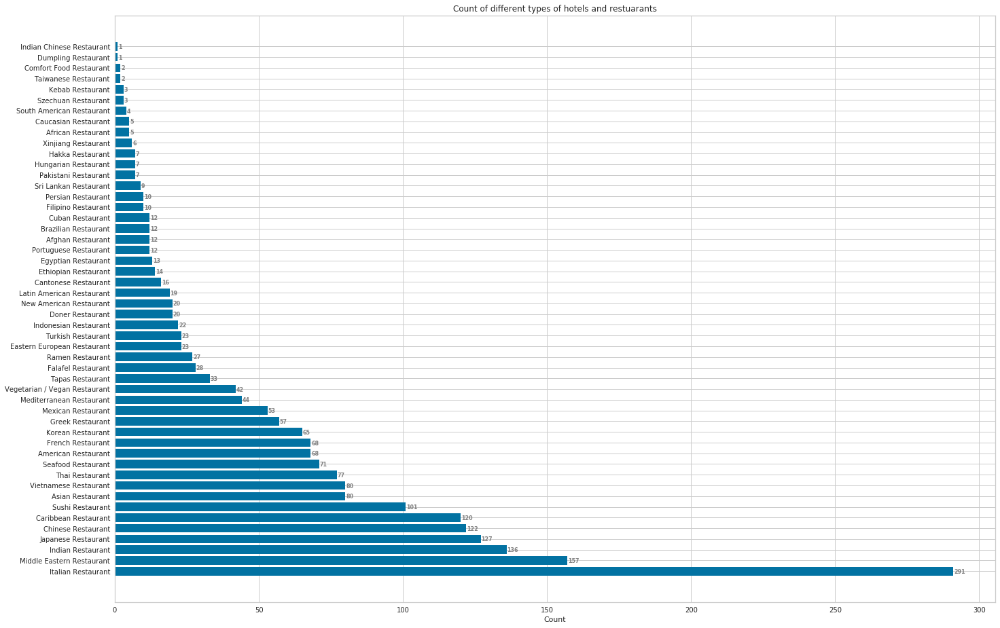

In [46]:
import matplotlib.pyplot as plt
fig = plt.figure()
ax = fig.add_axes([1,1,3,3])
pwf=wf[wf.index.isin(filter_category)].sort_values(by=['Venue Category'], ascending=False)
ax.barh(pwf.index,pwf['Venue Category'])
ax.set_xlabel("Count")
ax.set_title("Count of different types of hotels and restuarants")
# Add annotation to bars 
for i in ax.patches: 
    plt.text(i.get_width()+0.2, i.get_y()+0.2,  
             str(round((i.get_width()), 2)), 
             fontsize = 8, fontweight ='bold', 
             color ='grey') 
plt.show()

In [ ]:
# https://open.toronto.ca/dataset/neighbourhoods/
url = "https://ckan0.cf.opendata.inter.prod-toronto.ca/download_resource/a083c865-6d60-4d1d-b6c6-b0c8a85f9c15?format=geojson&projection=4326"
geodetails_data = requests.get(url).json()
def boroughs_style(feature):
    return { 'color': 'blue', 'fill': False }

In [ ]:
map_indian_restaurants_toranto = folium.Map(location=[latitude, longitude], zoom_start=11)
folium.GeoJson(geodetails_data, style_function=boroughs_style, name='geojson').add_to(map_indian_restaurants_toranto)
map_indian_restaurants_toranto

In [47]:
# create map of Toronto using latitude and longitude values for Indian Restuarant

toronto_indian_restaurant_venues = toronto_venues[toronto_venues['Venue Category'] == 'Indian Restaurant']
toronto_nonindian_restaurant_venues = toronto_venues[toronto_venues['Venue Category'] != 'Indian Restaurant']
map_indian_restaurants_toranto = folium.Map(location=[latitude, longitude], zoom_start=11)

#map_indian_restaurants_toranto.choropleth(
#geo_data=geodetails_data,
#name='choropleth',
#data=neighborhood_population_all,
#columns=['AREA_DESC','Population'],
#key_on='feature.properties.AREA_DESC',
#fill_color='YlGn',
#fill_opacity=0.7,
#line_opacity=0.2,
#legend_name='Population'
#)


# add markers to map
for lat, lng, venue in zip(toronto_nonindian_restaurant_venues['Venue Latitude'], toronto_nonindian_restaurant_venues['Venue Longitude'], toronto_nonindian_restaurant_venues['Venue']):
    label = '{}'.format(venue)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=label,
        color='orange',
        fill=True,
        fill_color='orange',
        fill_opacity=0.2,
        parse_html=False).add_to(map_indian_restaurants_toranto)  
# add markers to map
for lat, lng, venue in zip(toronto_indian_restaurant_venues['Venue Latitude'], toronto_indian_restaurant_venues['Venue Longitude'], toronto_indian_restaurant_venues['Venue']):
    label = '{}'.format(venue)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.7,
        parse_html=False).add_to(map_indian_restaurants_toranto) 
    
# add markers to map
#for lat, lng, areaname in zip(all_population_toronto_df['LATITUDE'], all_population_toronto_df['LONGITUDE'], all_population_toronto_df['AREA_NAME']):
#    label = '{}'.format(areaname)
#    label = folium.Popup(label, parse_html=True)
#    folium.Marker(
#        [lat, lng]).add_to(map_indian_restaurants_toranto) 

folium.GeoJson(geodetails_data, style_function=boroughs_style, name='geojson').add_to(map_indian_restaurants_toranto)
map_indian_restaurants_toranto


In [48]:
toronto_restaurant_venues = toronto_venues[toronto_venues['Venue Category'].isin(filter_category)]
toronto_restaurant_venues

,AREA NAME,AREA NAME Latitude,AREA NAME Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Agincourt North,43.805441,-79.266712,Fahmee Bakery & Jamaican Foods,43.810170,-79.280113,Caribbean Restaurant
1,Agincourt North,43.805441,-79.266712,Mona's Roti,43.791613,-79.251015,Caribbean Restaurant
2,Agincourt North,43.805441,-79.266712,The Roti Hut,43.787277,-79.258724,Caribbean Restaurant
4,Agincourt North,43.805441,-79.266712,Saravanaa Bhavan South Indian Restaurant,43.810117,-79.269275,Indian Restaurant
5,Agincourt North,43.805441,-79.266712,Fishman Lobster Clubhouse Restaurant 魚樂軒,43.801909,-79.295409,Chinese Restaurant
8,Agincourt North,43.805441,-79.266712,Samosa King - Embassy Restaurant,43.810152,-79.257316,Indian Restaurant
10,Agincourt North,43.805441,-79.266712,One2 Snacks,43.787048,-79.276658,Asian Restaurant
11,Agincourt North,43.805441,-79.266712,Babu Catering & Take Out,43.791721,-79.251132,Sri Lankan Restaurant
12,Agincourt North,43.805441,-79.266712,Chris Jerk Caribbean Bistro,43.789660,-79.302340,Caribbean Restaurant
15,Agincourt North,43.805441,-79.266712,Yummy Cantonese Restaurant 老西関腸粉,43.787568,-79.269585,Cantonese Restaurant


In [ ]:
# create map of Toronto using latitude and longitude values


map_restaurants_toranto = folium.Map(location=[latitude, longitude], zoom_start=11)

# add markers to map
for lat, lng, venue in zip(toronto_restaurant_venues['Venue Latitude'], toronto_restaurant_venues['Venue Longitude'], toronto_restaurant_venues['Venue']):
    label = '{}'.format(venue)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='orange',
        fill=True,
        fill_color='orange',
        fill_opacity=0.7,
        parse_html=False).add_to(map_restaurants_toranto)  
    
map_restaurants_toranto

In [50]:
toronto_indian_restaurant_venues.head()

,AREA NAME,AREA NAME Latitude,AREA NAME Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
4,Agincourt North,43.805441,-79.266712,Saravanaa Bhavan South Indian Restaurant,43.810117,-79.269275,Indian Restaurant
8,Agincourt North,43.805441,-79.266712,Samosa King - Embassy Restaurant,43.810152,-79.257316,Indian Restaurant
29,Agincourt North,43.805441,-79.266712,CANBE Foods Inc,43.773546,-79.246082,Indian Restaurant
31,Agincourt North,43.805441,-79.266712,Silver Spoon Pak-Indian Restaurant,43.791930,-79.251253,Indian Restaurant
111,Agincourt South-Malvern West,43.788658,-79.265612,CANBE Foods Inc,43.773546,-79.246082,Indian Restaurant


In [49]:
#toronto_restaurant_venues[toronto_restaurant_venues['Venue Category'] == 'Indian Restaurant']

toronto_indian_restaurant_venues_Count = pd.DataFrame(toronto_indian_restaurant_venues['AREA NAME '.value_counts())
toronto_indian_restaurant_venues_Count



SyntaxError: invalid syntax (<ipython-input-49-a628d9ec6209>, line 3)

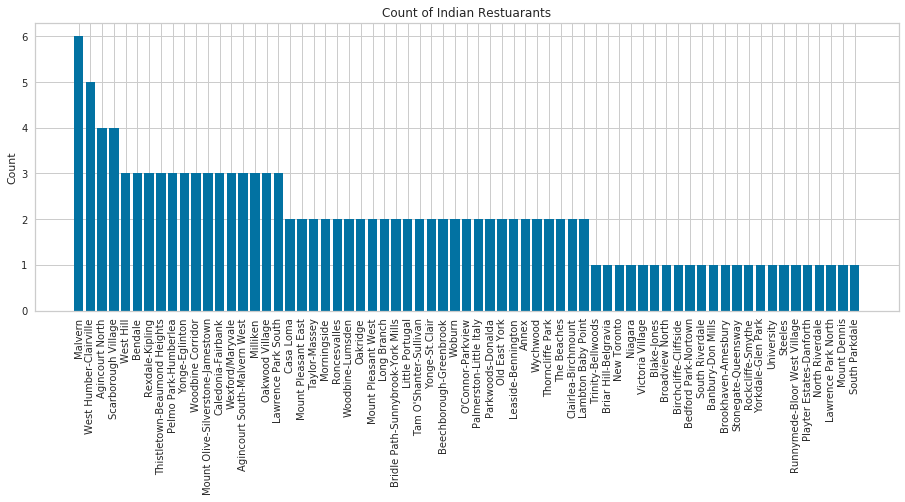

In [51]:
import matplotlib.pyplot as plt
fig = plt.figure()
ax = fig.add_axes([1,1,2,1])
ax.bar(indian_restuarant_venue_count_df['AREA NAME'],indian_restuarant_venue_count_df['Count'],align='center')
ax.set_ylabel("Count")
ax.set_title("Count of Indian Restuarants")

for tick in ax.get_xticklabels():
    tick.set_rotation(90)
plt.show()



In [ ]:
import matplotlib.pyplot as plt
fig = plt.figure()
ax = fig.add_axes([2,2,5,1])
ax.bar(indian_rest_df['Neighborhood'],indian_rest_df['Count'])
ax.set_ylabel("Count")
ax.set_title("Count of Indian Restuarants in Neighborhood")

for tick in ax.get_xticklabels():
    tick.set_rotation(90)
plt.show()



In [52]:
# one hot encoding
toronto_onehot = pd.get_dummies(toronto_restaurant_venues[['Venue Category']], prefix="", prefix_sep="")
# soumili toronto_onehot = pd.get_dummies(toronto_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
toronto_onehot['AREA NAME'] = toronto_restaurant_venues['AREA NAME'] 
# Soumili toronto_onehot['Neighborhood'] = toronto_venues['Neighborhood']

# move neighborhood column to the first column
fixed_columns = [toronto_onehot.columns[-1]] + list(toronto_onehot.columns[:-1])
toronto_onehot = toronto_onehot[fixed_columns]

toronto_onehot.head()

,AREA NAME,Afghan Restaurant,African Restaurant,American Restaurant,Asian Restaurant,Brazilian Restaurant,Cantonese Restaurant,Caribbean Restaurant,Caucasian Restaurant,Chinese Restaurant,Comfort Food Restaurant,Cuban Restaurant,Doner Restaurant,Dumpling Restaurant,Eastern European Restaurant,Egyptian Restaurant,Ethiopian Restaurant,Falafel Restaurant,Filipino Restaurant,French Restaurant,Greek Restaurant,Hakka Restaurant,Hungarian Restaurant,Indian Chinese Restaurant,Indian Restaurant,Indonesian Restaurant,Italian Restaurant,Japanese Restaurant,Kebab Restaurant,Korean Restaurant,Latin American Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,New American Restaurant,Pakistani Restaurant,Persian Restaurant,Portuguese Restaurant,Ramen Restaurant,Seafood Restaurant,South American Restaurant,Sri Lankan Restaurant,Sushi Restaurant,Szechuan Restaurant,Taiwanese Restaurant,Tapas Restaurant,Thai Restaurant,Turkish Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Xinjiang Restaurant
0,Agincourt North,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,Agincourt North,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,Agincourt North,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,Agincourt North,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,Agincourt North,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [53]:
toronto_grouped = toronto_onehot.groupby('AREA NAME').mean().reset_index()
toronto_grouped

,AREA NAME,Afghan Restaurant,African Restaurant,American Restaurant,Asian Restaurant,Brazilian Restaurant,Cantonese Restaurant,Caribbean Restaurant,Caucasian Restaurant,Chinese Restaurant,Comfort Food Restaurant,Cuban Restaurant,Doner Restaurant,Dumpling Restaurant,Eastern European Restaurant,Egyptian Restaurant,Ethiopian Restaurant,Falafel Restaurant,Filipino Restaurant,French Restaurant,Greek Restaurant,Hakka Restaurant,Hungarian Restaurant,Indian Chinese Restaurant,Indian Restaurant,Indonesian Restaurant,Italian Restaurant,Japanese Restaurant,Kebab Restaurant,Korean Restaurant,Latin American Restaurant,Mediterranean Restaurant,Mexican Restaurant,Middle Eastern Restaurant,New American Restaurant,Pakistani Restaurant,Persian Restaurant,Portuguese Restaurant,Ramen Restaurant,Seafood Restaurant,South American Restaurant,Sri Lankan Restaurant,Sushi Restaurant,Szechuan Restaurant,Taiwanese Restaurant,Tapas Restaurant,Thai Restaurant,Turkish Restaurant,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Xinjiang Restaurant
0,Agincourt North,0.000000,0.000000,0.000000,0.027027,0.000000,0.054054,0.135135,0.000000,0.216216,0.000000,0.000000,0.000000,0.000,0.000000,0.000000,0.000000,0.000000,0.027027,0.000000,0.027027,0.027027,0.000000,0.000000,0.108108,0.000000,0.027027,0.027027,0.000000,0.027027,0.000000,0.000000,0.054054,0.000000,0.000000,0.000000,0.000000,0.027027,0.000000,0.027027,0.000000,0.027027,0.054054,0.000000,0.000000,0.000000,0.000000,0.000000,0.054054,0.054054,0.000000
1,Agincourt South-Malvern West,0.000000,0.000000,0.025000,0.050000,0.000000,0.050000,0.125000,0.000000,0.150000,0.000000,0.000000,0.000000,0.025,0.000000,0.000000,0.000000,0.050000,0.000000,0.000000,0.050000,0.025000,0.000000,0.000000,0.075000,0.000000,0.050000,0.025000,0.000000,0.000000,0.000000,0.000000,0.025000,0.025000,0.000000,0.000000,0.000000,0.025000,0.000000,0.050000,0.000000,0.025000,0.050000,0.000000,0.000000,0.000000,0.025000,0.000000,0.025000,0.025000,0.025000
2,Alderwood,0.000000,0.000000,0.055556,0.055556,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.055556,0.000000,0.000000,0.000000,0.000000,0.000000,0.055556,0.055556,0.055556,0.000000,0.000000,0.000000,0.055556,0.111111,0.055556,0.000000,0.000000,0.055556,0.000000,0.166667,0.055556,0.000000,0.055556,0.000000,0.000000,0.000000,0.055556,0.000000,0.000000,0.055556,0.000000
3,Annex,0.000000,0.000000,0.052632,0.052632,0.000000,0.000000,0.052632,0.000000,0.000000,0.000000,0.000000,0.052632,0.000,0.000000,0.000000,0.000000,0.000000,0.000000,0.052632,0.000000,0.000000,0.000000,0.000000,0.105263,0.000000,0.105263,0.105263,0.000000,0.000000,0.000000,0.052632,0.052632,0.052632,0.000000,0.000000,0.000000,0.000000,0.000000,0.052632,0.000000,0.000000,0.000000,0.000000,0.000000,0.052632,0.052632,0.000000,0.052632,0.052632,0.000000
4,Banbury-Don Mills,0.035714,0.000000,0.035714,0.000000,0.000000,0.035714,0.071429,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.000000,0.000000,0.000000,0.035714,0.035714,0.035714,0.000000,0.000000,0.000000,0.035714,0.000000,0.071429,0.142857,0.000000,0.000000,0.000000,0.071429,0.035714,0.214286,0.035714,0.000000,0.000000,0.000000,0.000000,0.035714,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.035714,0.000000,0.000000,0.035714,0.000000
5,Bathurst Manor,0.000000,0.000000,0.000000,0.035714,0.000000,0.000000,0.035714,0.035714,0.000000,0.000000,0.000000,0.035714,0.000,0.035714,0.000000,0.000000,0.000000,0.000000,0.071429,0.000000,0.000000,0.000000,0.000000,0.000000,0.035714,0.071429,0.035714,0.000000,0.071429,0.000000,0.035714,0.000000,0.214286,0.000000,0.000000,0.000000,0.000000,0.035714,0.035714,0.000000,0.000000,0.071429,0.000000,0.000000,0.000000,0.107143,0.000000,0.000000,0.035714,0.000000
6,Bay Street Corridor,0.000000,0.000000,0.052632,0.000000,0.000000,0.000000,0.052632,0.000000,0.000000,0.000000,0.000000,0.052632,0.000,0.000000,0.000000,0.000000,0.000000,0.000

In [ ]:
num_top_venues = 5

for hood in toronto_grouped['AREA NAME']:
    print("----"+hood+"----")
    temp = toronto_grouped[toronto_grouped['AREA NAME'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

In [54]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [140]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['AREA NAME']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['AREA NAME'] = toronto_grouped['AREA NAME']

for ind in np.arange(toronto_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(toronto_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted

,AREA NAME,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Agincourt North,Chinese Restaurant,Caribbean Restaurant,Indian Restaurant,Vegetarian / Vegan Restaurant,Mexican Restaurant,Vietnamese Restaurant,Cantonese Restaurant,Sushi Restaurant,Japanese Restaurant,Italian Restaurant
1,Agincourt South-Malvern West,Chinese Restaurant,Caribbean Restaurant,Indian Restaurant,Falafel Restaurant,Greek Restaurant,Asian Restaurant,Italian Restaurant,Sushi Restaurant,Cantonese Restaurant,Seafood Restaurant
2,Alderwood,Seafood Restaurant,Middle Eastern Restaurant,Greek Restaurant,Mexican Restaurant,New American Restaurant,Japanese Restaurant,Italian Restaurant,Portuguese Restaurant,Vietnamese Restaurant,South American Restaurant
3,Annex,Indian Restaurant,Italian Restaurant,Japanese Restaurant,Caribbean Restaurant,Doner Restaurant,Vegetarian / Vegan Restaurant,Mediterranean Restaurant,Thai Restaurant,Tapas Restaurant,American Restaurant
4,Banbury-Don Mills,Middle Eastern Restaurant,Japanese Restaurant,Italian Restaurant,Mediterranean Restaurant,Caribbean Restaurant,Afghan Restaurant,Greek Restaurant,Filipino Restaurant,Indian Restaurant,Vietnamese Restaurant
5,Bathurst Manor,Middle Eastern Restaurant,Thai Restaurant,French Restaurant,Italian Restaurant,Korean Restaurant,Sushi Restaurant,Ramen Restaurant,Vietnamese Restaurant,Japanese Restaurant,Eastern European Restaurant
6,Bay Street Corridor,Italian Restaurant,Vegetarian / Vegan Restaurant,Japanese Restaurant,Seafood Restaurant,French Restaurant,Vietnamese Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Doner Restaurant,Caribbean Restaurant
7,Bayview Village,Korean Restaurant,Chinese Restaurant,Caribbean Restaurant,Thai Restaurant,Japanese Restaurant,Middle Eastern Restaurant,Sushi Restaurant,Ramen Restaurant,Persian Restaurant,Falafel Restaurant
8,Bayview Woods-Steeles,Korean Restaurant,Chinese Restaurant,Middle Eastern Restaurant,Japanese Restaurant,Sushi Restaurant,Greek Restaurant,Ramen Restaurant,Seafood Restaurant,Caribbean Restaurant,Thai Restaurant
9,Bedford Park-Nortown,Italian Restaurant,Indonesian Restaurant,Sushi Restaurant,American Restaurant,Thai Restaurant,French Restaurant,Indian Restaurant,Japanese Restaurant,Caribbean Restaurant,Seafood Restaurant


In [ ]:
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
categorical_features = ['AREA NAME']
test_neighborhoods_venues_sorted = toronto_grouped

for col in categorical_features:
    dummies = pd.get_dummies(test_neighborhoods_venues_sorted[col], prefix=col)
    test_neighborhoods_venues_sorted = pd.concat([test_neighborhoods_venues_sorted, dummies], axis=1)
    test_neighborhoods_venues_sorted.drop(col, axis=1, inplace=True)
test_neighborhoods_venues_sorted.head()



In [ ]:
mms = MinMaxScaler()
mms.fit(test_neighborhoods_venues_sorted)
data_transformed = mms.transform(test_neighborhoods_venues_sorted)

Sum_of_squared_distances = []
K = range(1,10)
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(data_transformed)
    Sum_of_squared_distances.append(km.inertia_)
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()


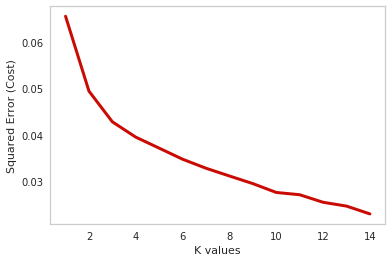

In [141]:
from sklearn.cluster import KMeans
toronto_grouped_df= toronto_grouped
toronto_part_clustering = toronto_grouped_df.drop('AREA NAME', 1)


error_cost = []

for i in range(1,15):
    KM = KMeans(n_clusters = i, max_iter = 100)
    try:
        KM.fit(toronto_part_clustering)
    except ValueError:
        print("error on line",i)
    
    
    
    
    #calculate squared error for the clustered points
    error_cost.append(KM.inertia_/100)

#plot the K values aganist the squared error cost
plt.plot(range(1,15), error_cost, color='r', linewidth='3')
plt.xlabel('K values')
plt.ylabel('Squared Error (Cost)')
plt.grid(color='white', linestyle='-', linewidth=2)
plt.show()

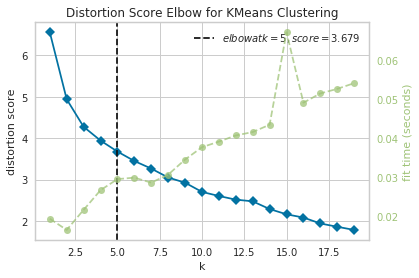

In [180]:
# Instantiate the clustering model and visualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(1,20))

visualizer.fit(toronto_part_clustering)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

In [181]:
# set number of clusters
kclusters = 5

toronto_grouped_clustering = toronto_grouped.drop('AREA NAME', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(toronto_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([1, 1, 2, 2, 4, 4, 3, 4, 4, 3], dtype=int32)

In [182]:
neighborhood_population.head()
neighborhood_population.rename(columns={'AREA_NAME_ACTUAL': 'AREA NAME'},inplace=True)


In [183]:
neighborhood_population.drop('AREA_NAME', axis=1, inplace=True)
neighborhood_population.drop('Population', axis=1, inplace=True)
neighborhood_population.head()

,AREA NAME
0,Agincourt North
1,Agincourt South-Malvern West
2,Alderwood
3,Annex
4,Banbury-Don Mills


In [184]:
df = population_toronto_df[~population_toronto_df['LATITUDE'].isnull()]
df1 = df[['AREA_NAME_FULL','LATITUDE','LONGITUDE']]
df1.rename(columns={'AREA_NAME_ACTUAL': 'AREA NAME'},inplace=True)

/opt/conda/envs/Python36/lib/python3.6/site-packages/pandas/core/frame.py:4025: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  return super(DataFrame, self).rename(**kwargs)


In [185]:
df1.rename(columns={'AREA_NAME_FULL': 'AREA NAME'},inplace=True)
df1.head()

,AREA NAME,LATITUDE,LONGITUDE
0,Agincourt North,43.805441,-79.266712
1,Agincourt South-Malvern West,43.788658,-79.265612
2,Alderwood,43.604937,-79.541611
3,Annex,43.671585,-79.404001
4,Banbury-Don Mills,43.737657,-79.349718


In [186]:
# add clustering labels
clustered_neighborhoods_venues_sorted = neighborhoods_venues_sorted
clustered_neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

toronto_merged = df1

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
toronto_merged = toronto_merged.join(clustered_neighborhoods_venues_sorted.set_index('AREA NAME'), on='AREA NAME')

toronto_merged

,AREA NAME,LATITUDE,LONGITUDE,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Agincourt North,43.805441,-79.266712,1.0,Chinese Restaurant,Caribbean Restaurant,Indian Restaurant,Vegetarian / Vegan Restaurant,Mexican Restaurant,Vietnamese Restaurant,Cantonese Restaurant,Sushi Restaurant,Japanese Restaurant,Italian Restaurant
1,Agincourt South-Malvern West,43.788658,-79.265612,1.0,Chinese Restaurant,Caribbean Restaurant,Indian Restaurant,Falafel Restaurant,Greek Restaurant,Asian Restaurant,Italian Restaurant,Sushi Restaurant,Cantonese Restaurant,Seafood Restaurant
2,Alderwood,43.604937,-79.541611,2.0,Seafood Restaurant,Middle Eastern Restaurant,Greek Restaurant,Mexican Restaurant,New American Restaurant,Japanese Restaurant,Italian Restaurant,Portuguese Restaurant,Vietnamese Restaurant,South American Restaurant
3,Annex,43.671585,-79.404001,2.0,Indian Restaurant,Italian Restaurant,Japanese Restaurant,Caribbean Restaurant,Doner Restaurant,Vegetarian / Vegan Restaurant,Mediterranean Restaurant,Thai Restaurant,Tapas Restaurant,American Restaurant
4,Banbury-Don Mills,43.737657,-79.349718,4.0,Middle Eastern Restaurant,Japanese Restaurant,Italian Restaurant,Mediterranean Restaurant,Caribbean Restaurant,Afghan Restaurant,Greek Restaurant,Filipino Restaurant,Indian Restaurant,Vietnamese Restaurant
5,Bathurst Manor,43.764813,-79.456055,4.0,Middle Eastern Restaurant,Thai Restaurant,French Restaurant,Italian Restaurant,Korean Restaurant,Sushi Restaurant,Ramen Restaurant,Vietnamese Restaurant,Japanese Restaurant,Eastern European Restaurant
6,Bay Street Corridor,43.657511,-79.385721,3.0,Italian Restaurant,Vegetarian / Vegan Restaurant,Japanese Restaurant,Seafood Restaurant,French Restaurant,Vietnamese Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Doner Restaurant,Caribbean Restaurant
7,Bayview Village,43.776361,-79.377117,4.0,Korean Restaurant,Chinese Restaurant,Caribbean Restaurant,Thai Restaurant,Japanese Restaurant,Middle Eastern Restaurant,Sushi Restaurant,Ramen Restaurant,Persian Restaurant,Falafel Restaurant
8,Bayview Woods-Steeles,43.796802,-79.382118,4.0,Korean Restaurant,Chinese Restaurant,Middle Eastern Restaurant,Japanese Restaurant,Sushi Restaurant,Greek Restaurant,Ramen Restaurant,Seafood Restaurant,Caribbean Restaurant,Thai Restaurant
9,Bedford Park-Nortown,43.731486,-79.420227,3.0,Italian Restaurant,Indonesian Restaurant,Sushi Restaurant,American Restaurant,Thai Restaurant,French Restaurant,Indian Restaurant,Japanese Restaurant,Caribbean Restaurant,Seafood Restaurant


In [ ]:
#toronto_merged.drop('Borough', axis=1, inplace=True)

In [ ]:
toronto_merged[~toronto_merged['Cluster Labels'].isnull()]

# Visualize the resulting clusters

In [197]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11,tiles='stamenwatercolor')

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]
tm = toronto_merged[~toronto_merged['Cluster Labels'].isnull()]
map_clusters.choropleth(
geo_data=geodetails_data,
name='choropleth',
data=neighborhood_population_all,
columns=['AREA_DESC','Population'],
key_on='feature.properties.AREA_DESC',
fill_color='RdPu',
fill_opacity=0.7,
line_opacity=0.2,
legend_name='Population'
)
# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(tm['LATITUDE'], tm['LONGITUDE'], tm['AREA NAME'], tm['Cluster Labels'].astype(int)):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)



       
map_clusters

In [ ]:
tp = tm

for item in tp.iterrows():
    print(item[1]['Neighborhood'])
    print(toronto_venues[toronto_venues['Venue Category'] == 'Indian Restuarant' and toronto_venues['Neighborhood'] == item[1]['Neighborhood']])

In [188]:
#cluster 1
toronto_merged.loc[toronto_merged['Cluster Labels'] == 0, toronto_merged.columns[[0] + list(range(1, toronto_merged.shape[1]))]]


,AREA NAME,LATITUDE,LONGITUDE,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
10,Beechborough-Greenbrook,43.693216,-79.479473,0.0,Italian Restaurant,Indian Restaurant,Falafel Restaurant,Greek Restaurant,Middle Eastern Restaurant,Vietnamese Restaurant,Brazilian Restaurant,Japanese Restaurant,Caribbean Restaurant,Sushi Restaurant
16,Bridle Path-Sunnybrook-York Mills,43.731013,-79.378904,0.0,Italian Restaurant,Japanese Restaurant,Indian Restaurant,Sushi Restaurant,Indonesian Restaurant,New American Restaurant,Cantonese Restaurant,Caribbean Restaurant,Chinese Restaurant,French Restaurant
20,Caledonia-Fairbank,43.688569,-79.455212,0.0,Italian Restaurant,Indian Restaurant,Middle Eastern Restaurant,Brazilian Restaurant,Japanese Restaurant,Caribbean Restaurant,Korean Restaurant,Falafel Restaurant,Seafood Restaurant,Cuban Restaurant
21,Casa Loma,43.681852,-79.408007,0.0,Italian Restaurant,Indian Restaurant,Indonesian Restaurant,Middle Eastern Restaurant,French Restaurant,Asian Restaurant,Tapas Restaurant,Vietnamese Restaurant,Caribbean Restaurant,Japanese Restaurant
69,Lawrence Park North,43.730060,-79.403978,0.0,Italian Restaurant,Sushi Restaurant,Indonesian Restaurant,New American Restaurant,Ramen Restaurant,Chinese Restaurant,Japanese Restaurant,Mexican Restaurant,Caribbean Restaurant,Asian Restaurant
70,Lawrence Park South,43.717212,-79.406039,0.0,Italian Restaurant,Indian Restaurant,Japanese Restaurant,Caribbean Restaurant,French Restaurant,Mediterranean Restaurant,Chinese Restaurant,Indonesian Restaurant,Caucasian Restaurant,Filipino Restaurant
71,Leaside-Bennington,43.703797,-79.366072,0.0,Italian Restaurant,Indian Restaurant,Indonesian Restaurant,Ramen Restaurant,American Restaurant,Ethiopian Restaurant,Greek Restaurant,Mediterranean Restaurant,Afghan Restaurant,Thai Restaurant
81,Mount Dennis,43.688144,-79.499989,0.0,Italian Restaurant,Falafel Restaurant,Vietnamese Restaurant,Tapas Restaurant,Japanese Restaurant,Seafood Restaurant,Chinese Restaurant,Sushi Restaurant,Indian Restaurant,Brazilian Restaurant
83,Mount Pleasant East,43.704852,-79.384924,0.0,Italian Restaurant,Indian Restaurant,Indonesian Restaurant,Sushi Restaurant,Chinese Restaurant,French Restaurant,Ramen Restaurant,Afghan Restaurant,Tapas Restaurant,Szechuan Restaurant
84,Mount Pleasant West,43.704435,-79.393360,0.0,Italian Restaurant,Indian Restaurant,Chinese Restaurant,Indonesian Restaurant,Asian Restaurant,Egyptian Restaurant,Indian Chinese Restaurant,Hungarian Restaurant,Hakka Restaurant,Greek Restaurant


In [189]:
#cluster 2
toronto_merged.loc[toronto_merged['Cluster Labels'] == 1, toronto_merged.columns[[0] + list(range(1, toronto_merged.shape[1]))]]

,AREA NAME,LATITUDE,LONGITUDE,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Agincourt North,43.805441,-79.266712,1.0,Chinese Restaurant,Caribbean Restaurant,Indian Restaurant,Vegetarian / Vegan Restaurant,Mexican Restaurant,Vietnamese Restaurant,Cantonese Restaurant,Sushi Restaurant,Japanese Restaurant,Italian Restaurant
1,Agincourt South-Malvern West,43.788658,-79.265612,1.0,Chinese Restaurant,Caribbean Restaurant,Indian Restaurant,Falafel Restaurant,Greek Restaurant,Asian Restaurant,Italian Restaurant,Sushi Restaurant,Cantonese Restaurant,Seafood Restaurant
11,Bendale,43.760366,-79.257400,1.0,Caribbean Restaurant,Middle Eastern Restaurant,Indian Restaurant,Chinese Restaurant,Italian Restaurant,Asian Restaurant,Greek Restaurant,Cantonese Restaurant,Korean Restaurant,Mediterranean Restaurant
74,Malvern,43.803658,-79.222517,1.0,Indian Restaurant,Caribbean Restaurant,Chinese Restaurant,Hakka Restaurant,Sri Lankan Restaurant,Asian Restaurant,Italian Restaurant,Cantonese Restaurant,Sushi Restaurant,Mexican Restaurant
77,Milliken,43.820691,-79.275009,1.0,Chinese Restaurant,Caribbean Restaurant,Indian Restaurant,Vegetarian / Vegan Restaurant,Hakka Restaurant,Asian Restaurant,Cantonese Restaurant,Sushi Restaurant,Vietnamese Restaurant,Japanese Restaurant
79,Morningside,43.782399,-79.207041,1.0,Caribbean Restaurant,Indian Restaurant,Italian Restaurant,Greek Restaurant,Mexican Restaurant,Sri Lankan Restaurant,Sushi Restaurant,Xinjiang Restaurant,Cantonese Restaurant,Asian Restaurant
82,Mount Olive-Silverstone-Jamestown,43.746868,-79.587259,1.0,Italian Restaurant,Asian Restaurant,Indian Restaurant,Chinese Restaurant,Caribbean Restaurant,Sushi Restaurant,Vietnamese Restaurant,Japanese Restaurant,Latin American Restaurant,Mexican Restaurant
97,Pelmo Park-Humberlea,43.717515,-79.528282,1.0,Vietnamese Restaurant,Indian Restaurant,Asian Restaurant,Chinese Restaurant,Sushi Restaurant,Caribbean Restaurant,Latin American Restaurant,Falafel Restaurant,New American Restaurant,Japanese Restaurant
99,Pleasant View,43.786982,-79.334948,1.0,Chinese Restaurant,Caribbean Restaurant,Japanese Restaurant,Middle Eastern Restaurant,Sushi Restaurant,Korean Restaurant,American Restaurant,Asian Restaurant,Falafel Restaurant,Mediterranean Restaurant
102,Rexdale-Kipling,43.723725,-79.566228,1.0,Chinese Restaurant,Asian Restaurant,Indian Restaurant,Vietnamese Restaurant,Japanese Restaurant,Sushi Restaurant,Caribbean Restaurant,Latin American Restaurant,Italian Restaurant,Mediterranean Restaurant


In [190]:
#cluster 3
toronto_merged.loc[toronto_merged['Cluster Labels'] == 2, toronto_merged.columns[[0] + list(range(1, toronto_merged.shape[1]))]]

,AREA NAME,LATITUDE,LONGITUDE,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
2,Alderwood,43.604937,-79.541611,2.0,Seafood Restaurant,Middle Eastern Restaurant,Greek Restaurant,Mexican Restaurant,New American Restaurant,Japanese Restaurant,Italian Restaurant,Portuguese Restaurant,Vietnamese Restaurant,South American Restaurant
3,Annex,43.671585,-79.404001,2.0,Indian Restaurant,Italian Restaurant,Japanese Restaurant,Caribbean Restaurant,Doner Restaurant,Vegetarian / Vegan Restaurant,Mediterranean Restaurant,Thai Restaurant,Tapas Restaurant,American Restaurant
12,Birchcliffe-Cliffside,43.694682,-79.265093,2.0,Vegetarian / Vegan Restaurant,Japanese Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Hungarian Restaurant,Turkish Restaurant,Thai Restaurant,Indian Restaurant,French Restaurant,Filipino Restaurant
14,Blake-Jones,43.676173,-79.337394,2.0,French Restaurant,Asian Restaurant,Greek Restaurant,Caribbean Restaurant,Mediterranean Restaurant,Latin American Restaurant,Ethiopian Restaurant,Japanese Restaurant,Italian Restaurant,Sushi Restaurant
23,Church-Yonge Corridor,43.659649,-79.379017,2.0,Vegetarian / Vegan Restaurant,Mediterranean Restaurant,Seafood Restaurant,Japanese Restaurant,French Restaurant,Middle Eastern Restaurant,Doner Restaurant,Italian Restaurant,Vietnamese Restaurant,American Restaurant
73,Long Branch,43.592362,-79.533345,2.0,Sushi Restaurant,Seafood Restaurant,Greek Restaurant,Middle Eastern Restaurant,Indian Restaurant,New American Restaurant,Vietnamese Restaurant,Mexican Restaurant,Kebab Restaurant,Japanese Restaurant
75,Maple Leaf,43.715574,-79.480758,2.0,Vietnamese Restaurant,Italian Restaurant,Middle Eastern Restaurant,Greek Restaurant,Falafel Restaurant,Japanese Restaurant,Caribbean Restaurant,New American Restaurant,Chinese Restaurant,Latin American Restaurant
76,Markland Wood,43.633542,-79.573432,2.0,Vietnamese Restaurant,Seafood Restaurant,Turkish Restaurant,American Restaurant,Eastern European Restaurant,Japanese Restaurant,Middle Eastern Restaurant,New American Restaurant,Greek Restaurant,Chinese Restaurant
80,Moss Park,43.656518,-79.367297,2.0,French Restaurant,Asian Restaurant,Japanese Restaurant,Mediterranean Restaurant,Middle Eastern Restaurant,Vegetarian / Vegan Restaurant,Thai Restaurant,American Restaurant,Italian Restaurant,Seafood Restaurant
89,North Riverdale,43.671995,-79.351260,2.0,French Restaurant,American Restaurant,Asian Restaurant,Greek Restaurant,Italian Restaurant,Mediterranean Restaurant,Latin American Restaurant,Ethiopian Restaurant,Japanese Restaurant,Sushi Restaurant


In [191]:
#cluster 4
toronto_merged.loc[toronto_merged['Cluster Labels'] == 3, toronto_merged.columns[[0] + list(range(1, toronto_merged.shape[1]))]]

,AREA NAME,LATITUDE,LONGITUDE,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
6,Bay Street Corridor,43.657511,-79.385721,3.0,Italian Restaurant,Vegetarian / Vegan Restaurant,Japanese Restaurant,Seafood Restaurant,French Restaurant,Vietnamese Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Doner Restaurant,Caribbean Restaurant
9,Bedford Park-Nortown,43.731486,-79.420227,3.0,Italian Restaurant,Indonesian Restaurant,Sushi Restaurant,American Restaurant,Thai Restaurant,French Restaurant,Indian Restaurant,Japanese Restaurant,Caribbean Restaurant,Seafood Restaurant
13,Black Creek,43.764890,-79.521979,3.0,Italian Restaurant,Middle Eastern Restaurant,Caribbean Restaurant,Asian Restaurant,Caucasian Restaurant,Eastern European Restaurant,Latin American Restaurant,Chinese Restaurant,Mexican Restaurant,Sushi Restaurant
15,Briar Hill-Belgravia,43.699024,-79.452851,3.0,Italian Restaurant,Greek Restaurant,Middle Eastern Restaurant,American Restaurant,Indian Restaurant,Brazilian Restaurant,Vietnamese Restaurant,Caribbean Restaurant,Sushi Restaurant,Chinese Restaurant
17,Broadview North,43.688825,-79.355630,3.0,Italian Restaurant,Asian Restaurant,Greek Restaurant,Afghan Restaurant,Egyptian Restaurant,Indian Restaurant,Turkish Restaurant,American Restaurant,Tapas Restaurant,Caribbean Restaurant
18,Brookhaven-Amesbury,43.701326,-79.485589,3.0,Italian Restaurant,Vietnamese Restaurant,Greek Restaurant,Falafel Restaurant,Japanese Restaurant,Latin American Restaurant,Chinese Restaurant,Seafood Restaurant,Caribbean Restaurant,Sushi Restaurant
22,Centennial Scarborough,43.782376,-79.150843,3.0,Italian Restaurant,Thai Restaurant,Japanese Restaurant,Chinese Restaurant,Mexican Restaurant,Xinjiang Restaurant,Eastern European Restaurant,Hakka Restaurant,Greek Restaurant,French Restaurant
67,Lambton Baby Point,43.657420,-79.496045,3.0,Italian Restaurant,Eastern European Restaurant,Indian Restaurant,Tapas Restaurant,Seafood Restaurant,American Restaurant,Brazilian Restaurant,Sushi Restaurant,French Restaurant,Cuban Restaurant
72,Little Portugal,43.647536,-79.430323,3.0,Italian Restaurant,Indian Restaurant,Cuban Restaurant,Seafood Restaurant,Vietnamese Restaurant,Japanese Restaurant,Eastern European Restaurant,Mexican Restaurant,Middle Eastern Restaurant,Doner Restaurant
85,New Toronto,43.600589,-79.510358,3.0,Italian Restaurant,Sushi Restaurant,Seafood Restaurant,Thai Restaurant,Middle Eastern Restaurant,Comfort Food Restaurant,Indian Restaurant,Japanese Restaurant,Mexican Restaurant,New American Restaurant


In [192]:
#cluster 5
toronto_merged.loc[toronto_merged['Cluster Labels'] == 4, toronto_merged.columns[[0] + list(range(1, toronto_merged.shape[1]))]]

,AREA NAME,LATITUDE,LONGITUDE,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
4,Banbury-Don Mills,43.737657,-79.349718,4.0,Middle Eastern Restaurant,Japanese Restaurant,Italian Restaurant,Mediterranean Restaurant,Caribbean Restaurant,Afghan Restaurant,Greek Restaurant,Filipino Restaurant,Indian Restaurant,Vietnamese Restaurant
5,Bathurst Manor,43.764813,-79.456055,4.0,Middle Eastern Restaurant,Thai Restaurant,French Restaurant,Italian Restaurant,Korean Restaurant,Sushi Restaurant,Ramen Restaurant,Vietnamese Restaurant,Japanese Restaurant,Eastern European Restaurant
7,Bayview Village,43.776361,-79.377117,4.0,Korean Restaurant,Chinese Restaurant,Caribbean Restaurant,Thai Restaurant,Japanese Restaurant,Middle Eastern Restaurant,Sushi Restaurant,Ramen Restaurant,Persian Restaurant,Falafel Restaurant
8,Bayview Woods-Steeles,43.796802,-79.382118,4.0,Korean Restaurant,Chinese Restaurant,Middle Eastern Restaurant,Japanese Restaurant,Sushi Restaurant,Greek Restaurant,Ramen Restaurant,Seafood Restaurant,Caribbean Restaurant,Thai Restaurant
25,Clairlea-Birchmount,43.713592,-79.281382,4.0,Middle Eastern Restaurant,Japanese Restaurant,Vegetarian / Vegan Restaurant,Thai Restaurant,Indian Restaurant,Korean Restaurant,French Restaurant,Mexican Restaurant,Vietnamese Restaurant,Seafood Restaurant
26,Clanton Park,43.741978,-79.446303,4.0,Sushi Restaurant,Chinese Restaurant,Indonesian Restaurant,Ramen Restaurant,Falafel Restaurant,Vietnamese Restaurant,Italian Restaurant,Japanese Restaurant,Korean Restaurant,Middle Eastern Restaurant
68,Lansing-Westgate,43.754271,-79.424748,4.0,Korean Restaurant,Middle Eastern Restaurant,Thai Restaurant,Japanese Restaurant,Sushi Restaurant,Ramen Restaurant,Indonesian Restaurant,Seafood Restaurant,Vietnamese Restaurant,Italian Restaurant
86,Newtonbrook East,43.791536,-79.405937,4.0,Korean Restaurant,Thai Restaurant,Middle Eastern Restaurant,Chinese Restaurant,Sushi Restaurant,Ramen Restaurant,Japanese Restaurant,French Restaurant,Vietnamese Restaurant,Caribbean Restaurant
87,Newtonbrook West,43.785830,-79.431422,4.0,Middle Eastern Restaurant,Korean Restaurant,Sushi Restaurant,Thai Restaurant,Japanese Restaurant,Ramen Restaurant,French Restaurant,Asian Restaurant,Caucasian Restaurant,Persian Restaurant
96,Parkwoods-Donalda,43.755033,-79.330180,4.0,Middle Eastern Restaurant,Caribbean Restaurant,Japanese Restaurant,Indian Restaurant,American Restaurant,Italian Restaurant,Mediterranean Restaurant,New American Restaurant,Persian Restaurant,Greek Restaurant


In [ ]:
#cluster 6
toronto_merged.loc[toronto_merged['Cluster Labels'] == 5, toronto_merged.columns[[1] + list(range(5, toronto_merged.shape[1]))]]

In [ ]:
#list of Neighborhood

url = "https://www.toronto.ca/city-government/data-research-maps/neighbourhoods-communities/neighbourhood-profiles/#neighbourhoodListNumeric"
page = urllib.request.urlopen(url)
soup = BeautifulSoup(page, "lxml")
post_table = soup.find('table', class_='listingtab table table-striped table-hover')
print(soup.prettify())
post_table